Extracting all of the features for each condition and putting into a large dataframe

In [1]:
unique_user_path_tracks = '/Volumes/Sam_002/Analysis/Replicates_actin/AP2_DNM2_MYO1E/All' # needs to be set for each user
unique_user_path_notebook = '/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/cmeAnalysisPostProcessingPythonScripts'
unique_user_saved_outputs = '/Users/samanthasmith/Documents/Drubin_Lab/Data/Replicates_actin/Outputs' 

In [8]:
%load_ext autoreload
%autoreload 2
import os
import sys
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython.display import Image
import itertools
import scipy.interpolate as interpolate
import scipy.stats as stats
from scipy import stats
import re
import seaborn as sns
import random
from glob import glob
sys.path.append(unique_user_path_notebook) # add custom Python scripts to the local path
sys.path.append(os.path.abspath(os.getcwd()+'Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/cmeAnalysisPostProcessingPythonScripts'))
source_code = os.getcwd()+'Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/cmeAnalysisPostProcessingPythonScripts'
from display_tracks import (load_tracks, load_tracks_no_sort, display_tracks,
                            remove_tracks_by_criteria, 
                            select_tracks_by_indices,
                            remove_tracks_by_indices,
                            plot_separated_cohorts)
import display_tracks
import merge_tools
import feature_extraction_with_buffer
import generate_index_dictionary
import return_track_attributes

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
index_dictionary = generate_index_dictionary.return_index_dictionary()

In [10]:
def filter_for_ccps(tracks_to_check,
                    minimum_ch2_counts=3,
                    sig_pval_cutoff=0.01,
                    minimum_lifetime=20,
                    maximum_lifetime=301,
                    initial_msd_threshold=0.02,
                    pixel_size=0.108):
    
    """return tracks that are sufficiently ch2 rich, not too long or not too short, and aren’t too speedy"""
    tracks_kept = [] # the CCPs we’re keeping
    for i in tqdm(range(len(tracks_to_check))): # iterate through all tracks
        # iterate through tracks that satisfy a condition:
        # and make sure track is category 1 (valids with good gaps)
        track_lifetime = return_track_attributes.return_track_lifetime(tracks_to_check, i)
        pvals = tracks_to_check[i][index_dictionary['index_pval_Ar']][1]
        significant_pval_indices = [1 if pval < sig_pval_cutoff else 0 for pval in pvals]
        repeated_indices = [(x[0], len(list(x[1]))) for x in itertools.groupby(significant_pval_indices)]
        max_1s = 0
        for itm in repeated_indices:
            if itm[0] == 1:
                if itm[1]>max_1s:
                    max_1s=itm[1]
        max_ch2_repeats = max_1s
        initial_msd = tracks_to_check[i][index_dictionary['index_MotionAnalysis']][0][0][1][0][0]
        initial_msd = pixel_size**2 * initial_msd
       
        if track_lifetime >= minimum_lifetime and \
           track_lifetime <= maximum_lifetime and \
           max_ch2_repeats >= minimum_ch2_counts and \
           initial_msd <= initial_msd_threshold:
            tracks_kept.append(tracks_to_check[i])
    return tracks_kept

In [11]:
def filter_for_ch3(tracks_to_check,
                    minimum_ch3_counts=3,
                    sig_pval_cutoff=0.01):
    
    """return tracks that are sufficiently ch3 rich, not too long or not too short, and aren’t too speedy"""
    tracks_kept = [] # the CCPs we’re keeping
    for i in tqdm(range(len(tracks_to_check))): # iterate through all tracks
        # iterate through tracks that satisfy a condition:
        # and make sure track is category 1 (valids with good gaps)
        track_lifetime = return_track_attributes.return_track_lifetime(tracks_to_check, i)
        pvals = tracks_to_check[i][index_dictionary['index_pval_Ar']][2]
        significant_pval_indices = [1 if pval < sig_pval_cutoff else 0 for pval in pvals]
        repeated_indices = [(x[0], len(list(x[1]))) for x in itertools.groupby(significant_pval_indices)]
        max_1s = 0
        for itm in repeated_indices:
            if itm[0] == 1:
                if itm[1]>max_1s:
                    max_1s=itm[1]
        max_ch3_repeats = max_1s
        
        if max_ch3_repeats >= minimum_ch3_counts:
            tracks_kept.append(tracks_to_check[i])
    return tracks_kept

In [12]:
#A function for creating a dataframe from loaded tracks
def condition_to_list_for_3(condition_tracks,
                            condition_label,
                            replicate_index,
                            cell_number):
    
    lifetimes = []
    max_int_ch1 = []
    max_int_ch2 = []
    max_int_ch3 = []
    max_consecutive_ch1 = []
    max_consecutive_ch2 = []
    max_consecutive_ch3 = []
    dist_traveled_ch1 = []
    dist_traveled_ch2 = []
    dist_traveled_ch3 = []
    md_ch1 = []
    md_ch2 = []
    md_ch3 = []
    track_category = []
    cell_id = []
    replicate = []
    condition_id = []

    for cond, tracks in enumerate(condition_tracks):

        features = feature_extraction_with_buffer.TrackFeatures(tracks) # an instance of a to-be feature matrix of tracks
        features.add_features(['lifetime', 
                               'max_int_ch0', 
                               'max_int_ch1', 
                               'max_int_ch2', 
                               'max_consecutive_significant_ch0',
                               'max_consecutive_significant_ch1',
                               'max_consecutive_significant_ch2', 
                               'dist_traveled_ch0',
                               'dist_traveled_ch1',
                               'dist_traveled_ch2',
                               'md_ch0',
                               'md_ch1',
                               'md_ch2',
                               'track_category']) # set the features to be extracted
        features.extract_features() # extract all features
        features = features.feature_matrix # feature matrix for all tracks

        lifetimes.append(features[:,0])
        max_int_ch1.append(features[:,1])
        max_int_ch2.append(features[:,2])
        max_int_ch3.append(features[:,3])
        max_consecutive_ch1.append(features[:,4])
        max_consecutive_ch2.append(features[:,5])
        max_consecutive_ch3.append(features[:,6])
        dist_traveled_ch1.append(features[:, 7])
        dist_traveled_ch2.append(features[:, 8])
        dist_traveled_ch3.append(features[:, 9])
        md_ch1.append(features[:, 10])
        md_ch2.append(features[:, 11])
        md_ch3.append(features[:, 12])
        track_category.append(features[:,13])

        cell_id.append([(str(condition_label) + '-' + str(cell_number)) for i in range(features.shape[0])])
        replicate.append([replicate_index for i in range(features.shape[0])])
        condition_id.append([condition_label for i in range(features.shape[0])])
        
    lifetimes = [lifetimes[i][j] for i in range(len(lifetimes)) for j in range(len(lifetimes[i]))]
    max_int_ch1 = [max_int_ch1[i][j] for i in range(len(max_int_ch1)) for j in range(len(max_int_ch1[i]))]
    max_int_ch2 = [max_int_ch2[i][j] for i in range(len(max_int_ch2)) for j in range(len(max_int_ch2[i]))]
    max_int_ch3 = [max_int_ch3[i][j] for i in range(len(max_int_ch3)) for j in range(len(max_int_ch3[i]))]
    max_consecutive_ch1 = [max_consecutive_ch1[i][j] for i in range(len(max_consecutive_ch1)) for j in range(len(max_consecutive_ch1[i]))]
    max_consecutive_ch2 = [max_consecutive_ch2[i][j] for i in range(len(max_consecutive_ch2)) for j in range(len(max_consecutive_ch2[i]))]
    max_consecutive_ch3 = [max_consecutive_ch3[i][j] for i in range(len(max_consecutive_ch3)) for j in range(len(max_consecutive_ch3[i]))]
    dist_traveled_ch1 = [dist_traveled_ch1[i][j] for i in range(len(dist_traveled_ch1)) for j in range(len(dist_traveled_ch1[i]))]
    dist_traveled_ch2 = [dist_traveled_ch2[i][j] for i in range(len(dist_traveled_ch2)) for j in range(len(dist_traveled_ch2[i]))]
    dist_traveled_ch3 = [dist_traveled_ch3[i][j] for i in range(len(dist_traveled_ch3)) for j in range(len(dist_traveled_ch3[i]))]
    md_ch1 = [md_ch1[i][j] for i in range(len(md_ch1)) for j in range(len(md_ch1[i]))]
    md_ch2 = [md_ch2[i][j] for i in range(len(md_ch2)) for j in range(len(md_ch2[i]))]
    md_ch3 = [md_ch3[i][j] for i in range(len(md_ch3)) for j in range(len(md_ch3[i]))]
    track_category = [track_category[i][j] for i in range(len(track_category)) for j in range(len(track_category[i]))]
    cell_id = [cell_id[i][j] for i in range(len(cell_id)) for j in range(len(cell_id[i]))]
    replicate = [replicate[i][j] for i in range(len(replicate)) for j in range(len(replicate[i]))]
    condition_id = [condition_id[i][j] for i in range(len(condition_id)) for j in range(len(condition_id[i]))]
 
        
    return lifetimes, max_int_ch1, max_int_ch2,max_int_ch3, max_consecutive_ch1, max_consecutive_ch2, max_consecutive_ch3, dist_traveled_ch1, dist_traveled_ch2, dist_traveled_ch3, md_ch1, md_ch2, md_ch3, track_category, cell_id, replicate, condition_id


In [13]:
condition_pathname = '/Volumes/Sam_002/Analysis/Osmotic_myosin'
conditions = [item for item in os.listdir(condition_pathname) if os.path.isdir(os.path.join(condition_pathname, item))]
conditions.sort()

processed_tracks_condition = []
processed_tracks_filepath = 'Ch1/Tracking/ProcessedTracks.mat'

for condition in conditions:
    tracks_path_condition = os.path.join(condition_pathname, condition)
    condition_cell_directories = [file for file in os.listdir(tracks_path_condition) if os.path.isdir(os.path.join(tracks_path_condition, file))]
    condition_cell_directories = [os.path.join(tracks_path_condition, file) for file in condition_cell_directories]
    for directory in condition_cell_directories:
        processed_tracks_condition.append(os.path.join(directory, processed_tracks_filepath))

print(len(processed_tracks_condition))


48


In [14]:
#For three color 

processed_tracks_filepath = 'Ch1/Tracking/ProcessedTracks.mat'

# Defining replicates in nested array
replicates_key = [[1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,3,3,3,3,3,3,3,3],[1,1,2,2,3,3],[1,1,2,2,3,3],[1,1,2,2,3,3],[1,1,2,2,3,3]]
                  
                  
conditions_key = [0,1,2,3,4]

# Master lists
master_condition_id = []
master_lifetimes = []
master_max_int_ch1 = []
master_max_int_ch2 = []
master_max_int_ch3 = []
master_max_consecutive_ch1 = []
master_max_consecutive_ch2 = []
master_max_consecutive_ch3 = []
master_dist_traveled_ch1 = []
master_dist_traveled_ch2 = []
master_dist_traveled_ch3 = []
master_md_ch1 = []
master_md_ch2 = []
master_md_ch3 = []
master_track_category = []
master_cell_id = []
master_replicate = []



for i, condition in enumerate(conditions):
    # Generating path for each cell in a condition
    tracks_path_condition = os.path.join(condition_pathname, condition)
    condition_cell_directories = [os.path.join(tracks_path_condition, file) for file in os.listdir(tracks_path_condition) if os.path.isdir(os.path.join(tracks_path_condition, file))]

    print(f"Condition {condition}:")
    print(f"  Length of replicates_key[{i}]: {len(replicates_key[i])}")
    print(f"  Length of condition_cell_directories: {len(condition_cell_directories)}")


    # Generating path for each processed track file in a condition
    processed_tracks_condition = [os.path.join(directory, processed_tracks_filepath) for directory in condition_cell_directories]

    if len(replicates_key[i]) < len(processed_tracks_condition):
        raise IndexError(f"replicates_key[{i}] does not have enough entries for all cells in condition '{condition}'.")

    # Filtering tracks of all cells in a condition, one at a time
    for ii, track_file in enumerate(processed_tracks_condition):
        loaded_tracks = []
        loaded_tracks.append(display_tracks.load_tracks(track_file))

        valid_tracks = []
        for tracks in loaded_tracks:
            valid_tracks.append(display_tracks.remove_tracks_by_criteria(tracks, track_category=[1,4]))

        filtered_valid_tracks = []
        for tracks in valid_tracks:
            temp_track_ccps = filter_for_ccps(
                tracks,
                minimum_ch2_counts=3,
                sig_pval_cutoff=0.01,
                minimum_lifetime=20,
                maximum_lifetime=301,
                initial_msd_threshold=0.02,
                pixel_size=0.108)

            
            #temp_track_ch3 = filter_for_ch3(temp_track_ccps,
                                            #minimum_ch3_counts=3,
                                            #sig_pval_cutoff=0.01)
            
            filtered_valid_tracks.append(temp_track_ccps)

        
            print(f" filtered valid tracks:{len(filtered_valid_tracks[0])}")
            
            

        # Using ii as index to retrieve replicate and condition_id correctly for each group
        lifetimes, max_int_ch1, max_int_ch2, max_int_ch3, max_consecutive_ch1, max_consecutive_ch2, max_consecutive_ch3,dist_traveled_ch1, dist_traveled_ch2, dist_traveled_ch3, md_ch1, md_ch2, md_ch3, track_category, cell_id, replicate, condition_id = condition_to_list_for_3(
            filtered_valid_tracks,
            conditions_key[i],
            replicates_key[i][ii],
            ii + 1)

        # Extending master lists with data for tracks with both channel 2 and 3 signals
        master_condition_id.extend(condition_id)
        master_lifetimes.extend(lifetimes)
        master_max_int_ch1.extend(max_int_ch1)
        master_max_int_ch2.extend(max_int_ch2)
        master_max_int_ch3.extend(max_int_ch3)
        master_max_consecutive_ch1.extend(max_consecutive_ch1)
        master_max_consecutive_ch2.extend(max_consecutive_ch2)
        master_max_consecutive_ch3.extend(max_consecutive_ch3)
        master_dist_traveled_ch1.extend(dist_traveled_ch1) 
        master_dist_traveled_ch2.extend(dist_traveled_ch2) 
        master_dist_traveled_ch3.extend(dist_traveled_ch3) 
        master_md_ch1.extend(md_ch1)
        master_md_ch2.extend(md_ch2)
        master_md_ch3.extend(md_ch3)
        master_track_category.extend(track_category)
        master_cell_id.extend(cell_id)
        master_replicate.extend(replicate)


Condition 0:
  Length of replicates_key[0]: 24
  Length of condition_cell_directories: 24
The number of tracks returned: 2863



100%|███████████████████████████████████| 2863/2863 [00:00<00:00, 100417.22it/s]

 filtered valid tracks:349


The number of tracks returned: 2799



100%|███████████████████████████████████| 2799/2799 [00:00<00:00, 144449.66it/s]

 filtered valid tracks:325


The number of tracks returned: 2241



100%|███████████████████████████████████| 2241/2241 [00:00<00:00, 146404.09it/s]

 filtered valid tracks:231


The number of tracks returned: 2236



100%|███████████████████████████████████| 2236/2236 [00:00<00:00, 147067.02it/s]

 filtered valid tracks:283


The number of tracks returned: 2500



100%|███████████████████████████████████| 2500/2500 [00:00<00:00, 133532.33it/s]

 filtered valid tracks:343


The number of tracks returned: 2391



100%|███████████████████████████████████| 2391/2391 [00:00<00:00, 129971.24it/s]

 filtered valid tracks:347


The number of tracks returned: 1873



100%|███████████████████████████████████| 1873/1873 [00:00<00:00, 146407.46it/s]

 filtered valid tracks:260


The number of tracks returned: 2491



100%|███████████████████████████████████| 2491/2491 [00:00<00:00, 162460.72it/s]

 filtered valid tracks:255


The number of tracks returned: 2507



100%|███████████████████████████████████| 2507/2507 [00:00<00:00, 150147.36it/s]

 filtered valid tracks:365


The number of tracks returned: 2668



100%|███████████████████████████████████| 2668/2668 [00:00<00:00, 157784.65it/s]

 filtered valid tracks:297


The number of tracks returned: 1990



100%|███████████████████████████████████| 1990/1990 [00:00<00:00, 148253.37it/s]

 filtered valid tracks:269


The number of tracks returned: 1986



100%|███████████████████████████████████| 1986/1986 [00:00<00:00, 138785.20it/s]

 filtered valid tracks:269


The number of tracks returned: 2123



100%|███████████████████████████████████| 2123/2123 [00:00<00:00, 133723.40it/s]

 filtered valid tracks:298


The number of tracks returned: 2274



100%|███████████████████████████████████| 2274/2274 [00:00<00:00, 137432.96it/s]

 filtered valid tracks:292


The number of tracks returned: 2123



100%|███████████████████████████████████| 2123/2123 [00:00<00:00, 145500.86it/s]

 filtered valid tracks:311


The number of tracks returned: 2414



100%|███████████████████████████████████| 2414/2414 [00:00<00:00, 153405.20it/s]

 filtered valid tracks:285


The number of tracks returned: 2270



100%|███████████████████████████████████| 2270/2270 [00:00<00:00, 143044.92it/s]

 filtered valid tracks:309


The number of tracks returned: 2481



100%|███████████████████████████████████| 2481/2481 [00:00<00:00, 150718.66it/s]

 filtered valid tracks:316


The number of tracks returned: 2116



100%|███████████████████████████████████| 2116/2116 [00:00<00:00, 142252.72it/s]

 filtered valid tracks:266


The number of tracks returned: 2265



100%|███████████████████████████████████| 2265/2265 [00:00<00:00, 158000.54it/s]

 filtered valid tracks:278


The number of tracks returned: 2232



100%|███████████████████████████████████| 2232/2232 [00:00<00:00, 142784.82it/s]

 filtered valid tracks:312


The number of tracks returned: 2327



100%|███████████████████████████████████| 2327/2327 [00:00<00:00, 145186.25it/s]

 filtered valid tracks:339


The number of tracks returned: 2549



100%|███████████████████████████████████| 2549/2549 [00:00<00:00, 164770.23it/s]

 filtered valid tracks:303


The number of tracks returned: 2441



100%|███████████████████████████████████| 2441/2441 [00:00<00:00, 154689.75it/s]

 filtered valid tracks:270
Condition 1:
  Length of replicates_key[1]: 6
  Length of condition_cell_directories: 6


The number of tracks returned: 2455



100%|███████████████████████████████████| 2455/2455 [00:00<00:00, 161132.58it/s]

 filtered valid tracks:235


The number of tracks returned: 2978



100%|███████████████████████████████████| 2978/2978 [00:00<00:00, 140810.97it/s]

 filtered valid tracks:387


The number of tracks returned: 2872



100%|███████████████████████████████████| 2872/2872 [00:00<00:00, 159848.74it/s]

 filtered valid tracks:327


The number of tracks returned: 1916



100%|███████████████████████████████████| 1916/1916 [00:00<00:00, 163675.16it/s]

 filtered valid tracks:217


The number of tracks returned: 1921



100%|███████████████████████████████████| 1921/1921 [00:00<00:00, 153139.05it/s]

 filtered valid tracks:183


The number of tracks returned: 1990



100%|███████████████████████████████████| 1990/1990 [00:00<00:00, 145882.46it/s]

 filtered valid tracks:233
Condition 2:
  Length of replicates_key[2]: 6
  Length of condition_cell_directories: 6


The number of tracks returned: 2280



100%|███████████████████████████████████| 2280/2280 [00:00<00:00, 155950.05it/s]

 filtered valid tracks:271


The number of tracks returned: 2443



100%|███████████████████████████████████| 2443/2443 [00:00<00:00, 149682.78it/s]

 filtered valid tracks:352


The number of tracks returned: 2388



100%|███████████████████████████████████| 2388/2388 [00:00<00:00, 136982.15it/s]

 filtered valid tracks:317


The number of tracks returned: 2547



100%|███████████████████████████████████| 2547/2547 [00:00<00:00, 166982.81it/s]

 filtered valid tracks:264


The number of tracks returned: 2401



100%|███████████████████████████████████| 2401/2401 [00:00<00:00, 151769.66it/s]

 filtered valid tracks:339


The number of tracks returned: 2416



100%|███████████████████████████████████| 2416/2416 [00:00<00:00, 158605.10it/s]

 filtered valid tracks:250
Condition 3:
  Length of replicates_key[3]: 6
  Length of condition_cell_directories: 6


The number of tracks returned: 3335



100%|███████████████████████████████████| 3335/3335 [00:00<00:00, 161235.71it/s]

 filtered valid tracks:318


The number of tracks returned: 3798



100%|███████████████████████████████████| 3798/3798 [00:00<00:00, 161671.39it/s]

 filtered valid tracks:344


The number of tracks returned: 3020



100%|███████████████████████████████████| 3020/3020 [00:00<00:00, 158915.02it/s]

 filtered valid tracks:353


The number of tracks returned: 2949



100%|███████████████████████████████████| 2949/2949 [00:00<00:00, 145191.42it/s]

 filtered valid tracks:417


The number of tracks returned: 2828



100%|███████████████████████████████████| 2828/2828 [00:00<00:00, 164617.19it/s]

 filtered valid tracks:345


The number of tracks returned: 2714



100%|███████████████████████████████████| 2714/2714 [00:00<00:00, 155825.18it/s]

 filtered valid tracks:280


Condition 4:
  Length of replicates_key[4]: 6
  Length of condition_cell_directories: 6
The number of tracks returned: 2643



100%|███████████████████████████████████| 2643/2643 [00:00<00:00, 155599.71it/s]

 filtered valid tracks:232


The number of tracks returned: 4000



100%|███████████████████████████████████| 4000/4000 [00:00<00:00, 161096.33it/s]

 filtered valid tracks:353


The number of tracks returned: 4032



100%|███████████████████████████████████| 4032/4032 [00:00<00:00, 159855.51it/s]

 filtered valid tracks:389


The number of tracks returned: 3366



100%|████████████████████████████████████| 3366/3366 [00:00<00:00, 91664.19it/s]

 filtered valid tracks:368


The number of tracks returned: 2926



100%|███████████████████████████████████| 2926/2926 [00:00<00:00, 140693.27it/s]

 filtered valid tracks:342


The number of tracks returned: 2771



100%|███████████████████████████████████| 2771/2771 [00:00<00:00, 151199.67it/s]

 filtered valid tracks:256


In [56]:
array_features_master = np.array([master_lifetimes, master_max_int_ch1, master_max_int_ch2,master_max_int_ch3, master_max_consecutive_ch1, master_max_consecutive_ch2, master_max_consecutive_ch3, master_dist_traveled_ch1,master_dist_traveled_ch2,master_dist_traveled_ch3,master_md_ch1,master_md_ch2,master_md_ch3, master_track_category, master_condition_id, master_replicate], dtype=object).T
df_features_master = pd.DataFrame(data=array_features_master, columns=['lifetime', 'max_ch1', 'max_ch2','max_ch3', 'ch1_lifetime','ch2_lifetime', 'ch3_lifetime','ch1_dist','ch2_dist','ch3_dist', 'md_ch1', 'md_ch2', 'md_ch3','track_category','condition', 'replicate'])
df_features_master['cell_id'] = master_cell_id

In [57]:
df_features_master

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
0,301.0,150.871123,588.460376,234.915544,301.0,86.0,40.0,0.573395,1.058139,1.531325,0.348282,0.852786,1.307441,4.0,0,1,0-1
1,301.0,143.860747,268.176994,82.829067,301.0,251.0,62.0,3.466753,4.787596,3.466753,0.34991,0.555578,0.880829,4.0,0,1,0-1
2,301.0,71.524464,347.694547,50.449982,301.0,198.0,7.0,3.3825,4.718568,3.3825,0.487526,0.290306,0.968377,4.0,0,1,0-1
3,301.0,103.221347,360.252165,118.208045,301.0,223.0,82.0,20.953275,22.488462,21.439355,0.470365,0.459736,0.991911,4.0,0,1,0-1
4,301.0,166.732046,282.928861,72.344116,301.0,185.0,14.0,3.285429,4.207823,3.285429,0.327752,0.505903,0.853062,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2827,20.0,27.727537,60.801449,4.768178,7.0,5.0,0.0,1.572144,1.997042,1.700662,1.138832,1.095779,0.834029,1.0,2,3,2-3
2828,20.0,39.50852,133.226469,38.375433,5.0,20.0,4.0,0.867525,2.033636,1.392255,0.93544,1.008861,1.078032,1.0,2,3,2-3
2829,20.0,33.8911,105.076929,53.528141,8.0,17.0,25.0,1.306834,1.273437,1.647905,1.080682,0.45412,0.833539,1.0,2,3,2-3
2830,20.0,40.117777,76.080121,20.700282,18.0,9.0,1.0,0.975758,0.991798,2.339953,0.739275,1.154555,1.125659,1.0,2,3,2-3


In [58]:
df_high_ch3 = df_features_master[df_features_master['ch3_lifetime'] >= 3]
df_low_ch3 = df_features_master[df_features_master['ch3_lifetime'] < 3]

In [59]:
df_high_ch3

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
0,301.0,150.871123,588.460376,234.915544,301.0,86.0,40.0,0.573395,1.058139,1.531325,0.348282,0.852786,1.307441,4.0,0,1,0-1
1,301.0,143.860747,268.176994,82.829067,301.0,251.0,62.0,3.466753,4.787596,3.466753,0.34991,0.555578,0.880829,4.0,0,1,0-1
2,301.0,71.524464,347.694547,50.449982,301.0,198.0,7.0,3.3825,4.718568,3.3825,0.487526,0.290306,0.968377,4.0,0,1,0-1
3,301.0,103.221347,360.252165,118.208045,301.0,223.0,82.0,20.953275,22.488462,21.439355,0.470365,0.459736,0.991911,4.0,0,1,0-1
4,301.0,166.732046,282.928861,72.344116,301.0,185.0,14.0,3.285429,4.207823,3.285429,0.327752,0.505903,0.853062,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2816,22.0,62.488601,193.102027,110.44321,19.0,14.0,32.0,3.313273,2.21956,5.374946,1.115213,0.733309,0.29993,1.0,2,3,2-3
2817,21.0,53.690935,236.907678,246.288621,21.0,21.0,16.0,2.318865,1.863046,3.923514,1.150295,0.626568,0.997888,1.0,2,3,2-3
2828,20.0,39.50852,133.226469,38.375433,5.0,20.0,4.0,0.867525,2.033636,1.392255,0.93544,1.008861,1.078032,1.0,2,3,2-3
2829,20.0,33.8911,105.076929,53.528141,8.0,17.0,25.0,1.306834,1.273437,1.647905,1.080682,0.45412,0.833539,1.0,2,3,2-3


In [60]:
df_low_ch3

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
34,301.0,160.563387,473.010669,36.477074,301.0,100.0,2.0,12.428494,11.580244,12.824291,0.299446,0.525555,0.904714,4.0,0,1,0-1
36,301.0,108.146105,248.203408,21.714198,301.0,70.0,0.0,6.44657,5.492788,6.44657,0.291562,0.737461,0.946914,4.0,0,1,0-1
38,301.0,103.162755,226.296561,23.735335,301.0,245.0,0.0,6.070133,6.379958,8.194907,0.360153,0.594281,1.472163,4.0,0,1,0-1
39,301.0,84.379959,56.090617,23.705986,301.0,7.0,1.0,5.037437,7.200849,2.634416,0.322011,1.655557,1.7085,4.0,0,1,0-1
41,301.0,117.354199,140.956499,25.248736,301.0,83.0,0.0,4.207202,4.093383,4.207202,0.279451,0.697057,0.439316,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2824,21.0,29.116994,46.846158,10.521239,5.0,4.0,0.0,2.021498,2.344834,1.70437,1.345259,0.83749,1.171006,1.0,2,3,2-3
2825,20.0,30.480076,43.1399,2.001763,11.0,3.0,0.0,0.956342,2.662769,1.684941,0.810037,1.543036,0.373334,1.0,2,3,2-3
2826,20.0,29.628547,104.116406,10.239465,6.0,20.0,0.0,3.241383,1.921018,1.747064,1.070019,0.48424,0.355682,1.0,2,3,2-3
2827,20.0,27.727537,60.801449,4.768178,7.0,5.0,0.0,1.572144,1.997042,1.700662,1.138832,1.095779,0.834029,1.0,2,3,2-3


In [61]:
df_high_ch3.to_csv('three_color_tracking_ada_control_replicates.csv', index=False)

In [62]:
df_low_ch3.to_csv('two_color_tracking_ada_control_replicates.csv', index=False)

In [444]:
import os
import glob
import tifffile
folder_path = '/Volumes/Sam_002/Analysis/Osmotic_arpc3_20per'

# Find all cellmask.tif files recursively
mask_paths = glob.glob(os.path.join(folder_path, '**', 'cellmask.tif'), recursive=True)

# Load each mask into a list
all_cell_masks = []
for path in mask_paths:
    mask = tifffile.imread(path)
    all_cell_masks.append(mask)

print(len(all_cell_masks))

48


In [445]:
file_paths = glob.glob(os.path.join(folder_path, '**', 'Ch1', 'C1-*.tif'), recursive=True)
all_cell_tiffs = []
for path in file_paths:
    tiff = tifffile.imread(path)
    all_cell_tiffs.append(tiff)

print(len(all_cell_tiffs))



48


/var/folders/dr/7wv8s9zx3kz0dvq5s3ss_ttc0000gn/T/ipykernel_11025/3480817017.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 5))


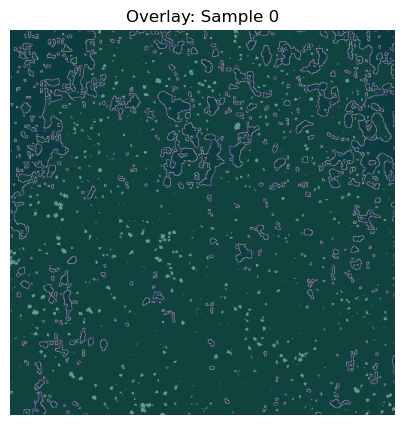

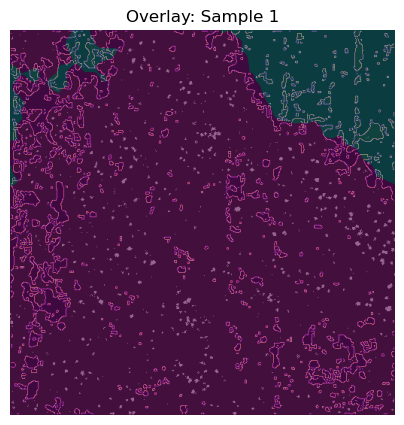

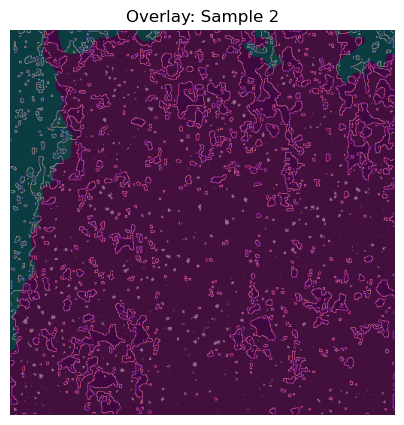

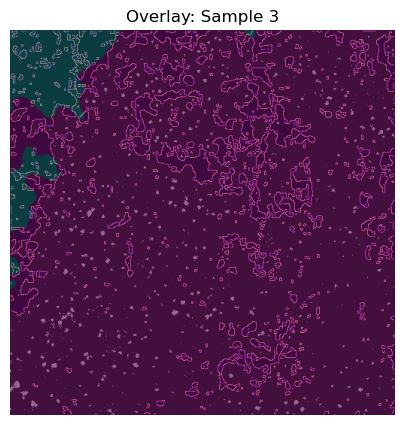

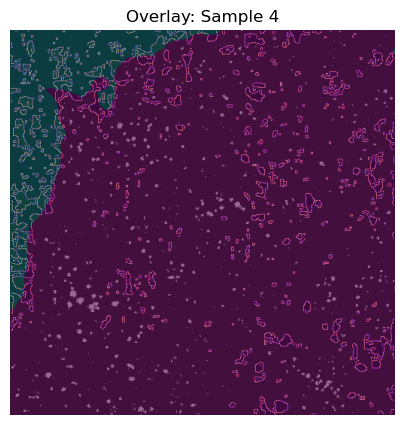

...

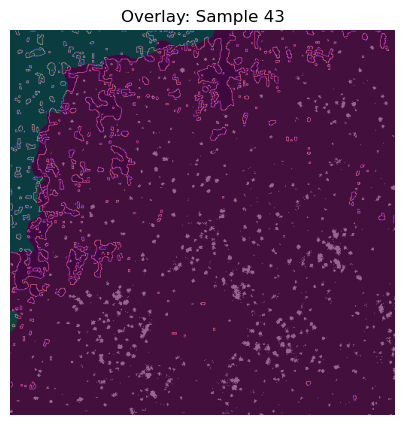

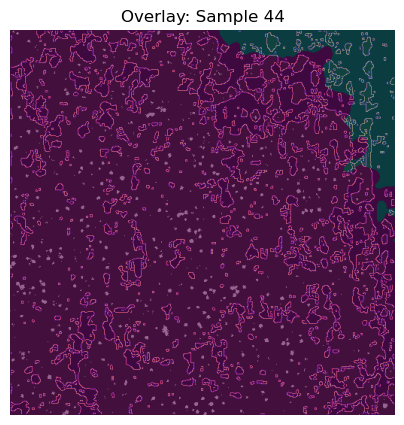

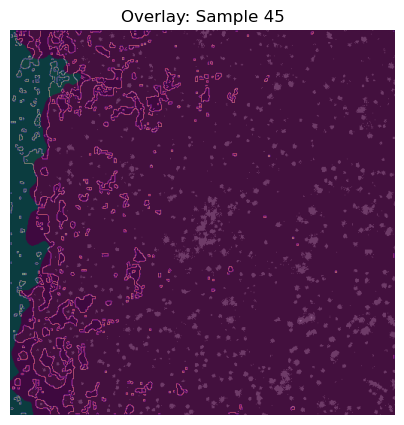

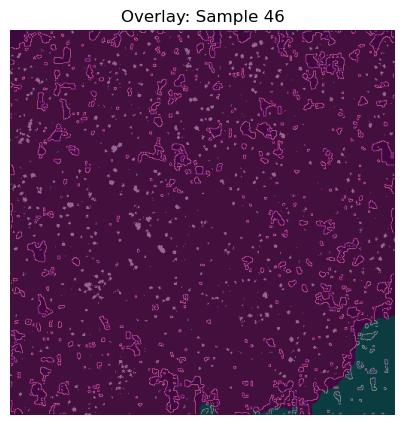

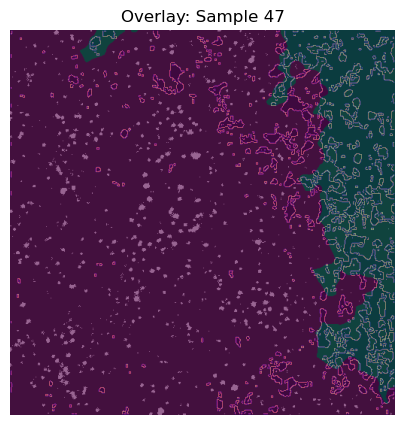

In [147]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import median
from skimage.morphology import disk
from skimage import feature, exposure

# List to store the fraction of "cell pixels" per image
all_cell_mask_cell_pixel_fraction = []

for i, raw_stack in enumerate(all_cell_tiffs):
    # Use the first frame of the image stack
    raw_image = raw_stack[0]

    # Convert to grayscale if needed
    if raw_image.ndim == 3 and raw_image.shape[2] == 3:
        grayscale_image = rgb2gray(raw_image)
    else:
        grayscale_image = raw_image

    # Smooth the grayscale image
    grayscale_image = median(grayscale_image, disk(5))

    # Calculate a threshold from the 10th percentile
    percentile_threshold = np.percentile(grayscale_image.flatten(), 10)

    # Find edges using the Canny detector
    thresholded = grayscale_image > percentile_threshold
    edges = feature.canny(thresholded, sigma=1)

    # Overlay visualization
    plt.figure(figsize=(5, 5))
    plt.imshow(exposure.adjust_gamma(raw_image, 0.00001), alpha=0.9, cmap='gray')
    plt.imshow(thresholded, alpha=0.08, cmap='viridis')
    plt.imshow(edges, alpha=0.5, cmap='magma')
    plt.imshow(all_cell_masks[i], alpha=0.2, cmap='cool')  # Assumes binary mask

    plt.axis('off')
    plt.title(f'Overlay: Sample {i}')
    # plt.show()  # Uncomment to display

    # Calculate the fraction of image area above threshold
    cell_pixel_fraction = thresholded.sum() / (thresholded.shape[0] * thresholded.shape[1])
    all_cell_mask_cell_pixel_fraction.append(cell_pixel_fraction)


Text(0, 0.5, 'counts')

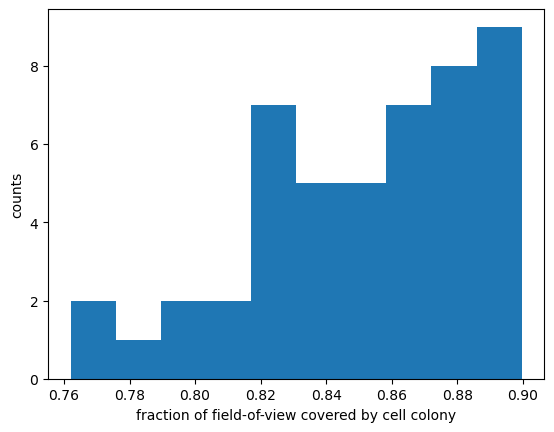

In [148]:
plt.hist(all_cell_mask_cell_pixel_fraction)
plt.xlabel('fraction of field-of-view covered by cell colony')
plt.ylabel('counts')

In [149]:
df = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_arpc3_osmotic_shock.csv')


In [150]:
df

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
0,301.0,235.452121,362.239235,103.323396,301.0,272.0,19.0,11.351544,12.602938,10.935505,0.340316,0.421110,0.791221,4.0,0,1,0-1
1,301.0,192.093923,688.115274,846.214071,301.0,94.0,116.0,4.615408,5.433704,3.639090,0.268044,0.681442,0.293734,4.0,0,1,0-1
2,301.0,242.375038,257.235978,703.419874,301.0,113.0,38.0,9.648803,9.662083,9.701559,0.316612,0.978828,0.869197,4.0,0,1,0-1
3,301.0,95.275189,304.808597,596.843200,301.0,85.0,10.0,7.664193,7.601938,7.664193,0.406973,0.467749,0.618242,4.0,0,1,0-1
4,301.0,151.532054,235.245537,150.926065,301.0,106.0,24.0,2.693844,2.663848,2.693844,0.438494,0.706984,0.620193,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11807,22.0,38.409054,455.563197,1806.357570,10.0,15.0,32.0,4.233539,1.329120,0.802131,1.146507,0.565367,0.322058,1.0,4,3,4-6
11808,22.0,46.234919,700.688776,629.938414,12.0,22.0,3.0,2.073671,1.269785,3.361206,1.180578,0.213426,0.520908,1.0,4,3,4-6
11809,21.0,35.555004,119.043815,567.704043,10.0,7.0,7.0,1.280883,2.448225,2.604967,1.297411,0.719445,0.861697,1.0,4,3,4-6
11810,21.0,37.406877,542.706770,232.815722,10.0,21.0,20.0,1.987768,1.066838,4.579294,0.729060,0.515346,0.468281,1.0,4,3,4-6


In [151]:
df_track_cat1 = df[df['track_category'] == 1]


In [152]:
df_track_cat1

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
76,275.0,166.464082,215.051461,230.731257,252.0,37.0,57.0,4.729231,4.068313,7.394982,0.424617,1.177585,1.352052,1.0,0,1,0-1
77,266.0,217.536535,308.786780,399.332584,255.0,120.0,29.0,3.181642,3.946879,4.380996,0.476445,0.831229,0.848196,1.0,0,1,0-1
78,244.0,139.115088,272.995742,186.450923,223.0,80.0,18.0,27.348828,24.339479,21.606088,0.517828,0.894437,1.915785,1.0,0,1,0-1
79,240.0,125.633986,210.051041,326.472993,235.0,51.0,17.0,1.286378,5.118118,3.269917,0.440588,0.886334,1.081800,1.0,0,1,0-1
80,224.0,171.894380,580.054619,759.414973,212.0,102.0,9.0,12.815957,9.590555,10.190240,0.604435,0.721779,0.631724,1.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11807,22.0,38.409054,455.563197,1806.357570,10.0,15.0,32.0,4.233539,1.329120,0.802131,1.146507,0.565367,0.322058,1.0,4,3,4-6
11808,22.0,46.234919,700.688776,629.938414,12.0,22.0,3.0,2.073671,1.269785,3.361206,1.180578,0.213426,0.520908,1.0,4,3,4-6
11809,21.0,35.555004,119.043815,567.704043,10.0,7.0,7.0,1.280883,2.448225,2.604967,1.297411,0.719445,0.861697,1.0,4,3,4-6
11810,21.0,37.406877,542.706770,232.815722,10.0,21.0,20.0,1.987768,1.066838,4.579294,0.729060,0.515346,0.468281,1.0,4,3,4-6


In [153]:
condition_counts = (
    df_track_cat1
    .groupby(['condition','replicate','cell_id'])
    .size()
    .reset_index(name='event_count')
)

In [154]:
# Step 1: Add pixel fractions to the condition_counts DataFrame
# Assuming the order of all_cell_mask_cell_pixel_fraction matches the rows in condition_counts
condition_counts['pixel_fraction'] = all_cell_mask_cell_pixel_fraction

# Step 2: Define normalization factor
normalization_factor = 0.108 * 0.108 * 512 * 512 * 5  # in microns² and per 5 minutes

# Step 3: Compute initiation rates
condition_counts['initiation_rate'] = (
    condition_counts['event_count'] / (condition_counts['pixel_fraction'] * normalization_factor)
)


In [155]:
# Group by condition + replicate to get mean per replicate
replicate_means = (
    condition_counts
    .groupby(['condition', 'replicate'])['initiation_rate']
    .mean()
    .reset_index(name='mean_initiation_rate')
)


In [159]:
import os
import glob
import tifffile
folder_path = '/Volumes/Sam_002/Analysis/Osmotic_myosin_ko/CMEtracks'

# Find all cellmask.tif files recursively
mask_paths = glob.glob(os.path.join(folder_path, '**', 'cellmask.tif'), recursive=True)

# Load each mask into a list
all_cell_masks = []
for path in mask_paths:
    mask = tifffile.imread(path)
    all_cell_masks.append(mask)

print(len(all_cell_masks))

50


In [160]:
file_paths = glob.glob(os.path.join(folder_path, '**', 'Ch1', 'C1-*.tif'), recursive=True)
all_cell_tiffs = []
for path in file_paths:
    tiff = tifffile.imread(path)
    all_cell_tiffs.append(tiff)

print(len(all_cell_tiffs))



50


/var/folders/dr/7wv8s9zx3kz0dvq5s3ss_ttc0000gn/T/ipykernel_11025/3480817017.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 5))


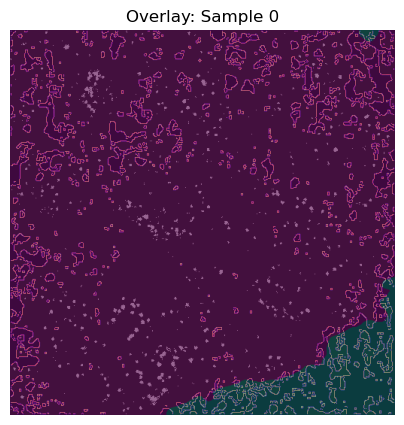

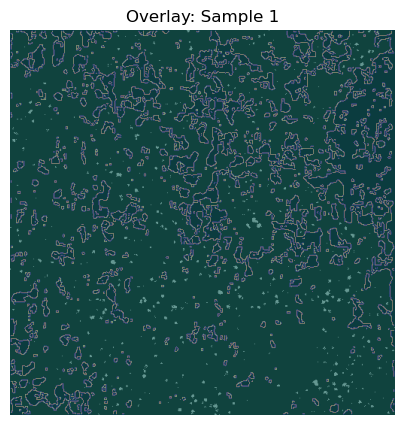

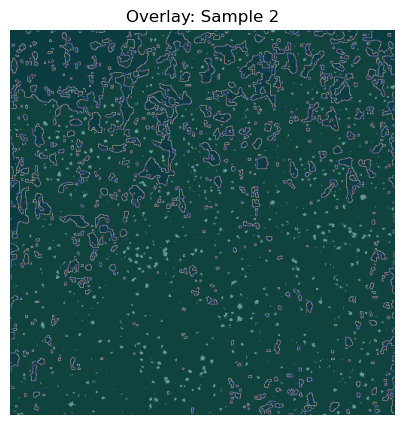

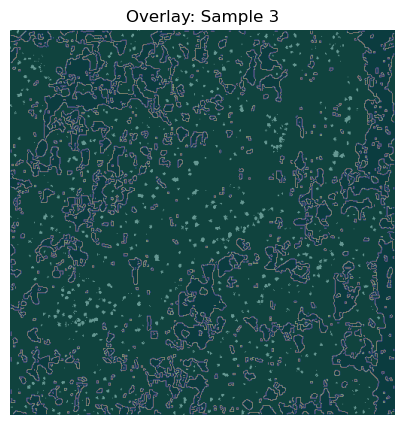

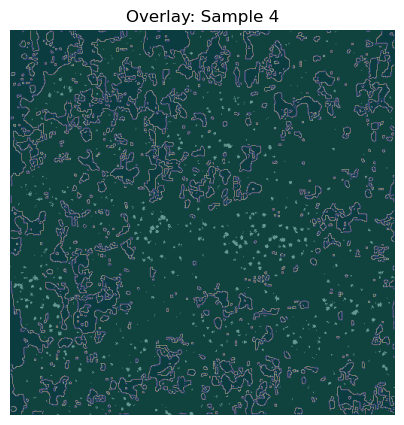

...

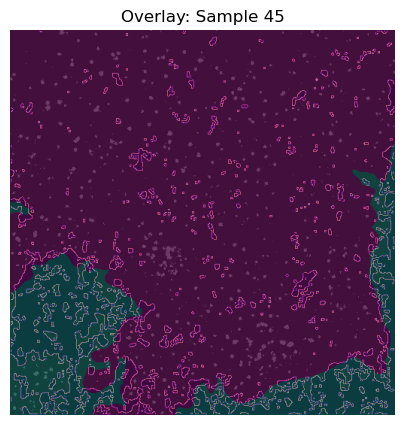

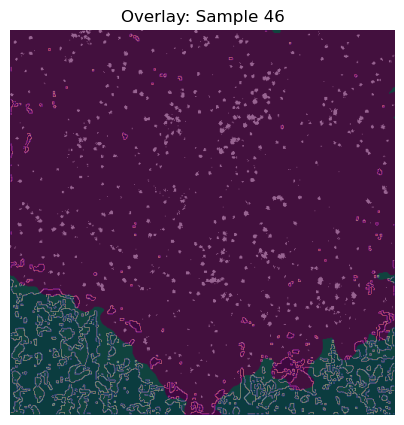

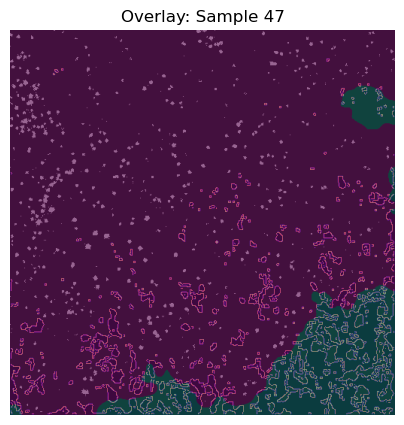

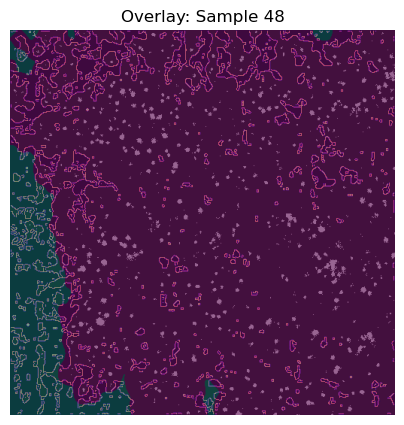

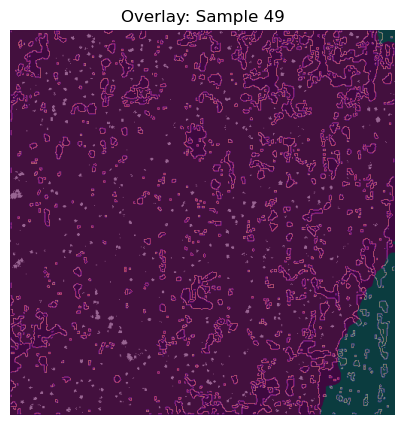

In [161]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import median
from skimage.morphology import disk
from skimage import feature, exposure

# List to store the fraction of "cell pixels" per image
all_cell_mask_cell_pixel_fraction = []

for i, raw_stack in enumerate(all_cell_tiffs):
    # Use the first frame of the image stack
    raw_image = raw_stack[0]

    # Convert to grayscale if needed
    if raw_image.ndim == 3 and raw_image.shape[2] == 3:
        grayscale_image = rgb2gray(raw_image)
    else:
        grayscale_image = raw_image

    # Smooth the grayscale image
    grayscale_image = median(grayscale_image, disk(5))

    # Calculate a threshold from the 10th percentile
    percentile_threshold = np.percentile(grayscale_image.flatten(), 10)

    # Find edges using the Canny detector
    thresholded = grayscale_image > percentile_threshold
    edges = feature.canny(thresholded, sigma=1)

    # Overlay visualization
    plt.figure(figsize=(5, 5))
    plt.imshow(exposure.adjust_gamma(raw_image, 0.00001), alpha=0.9, cmap='gray')
    plt.imshow(thresholded, alpha=0.08, cmap='viridis')
    plt.imshow(edges, alpha=0.5, cmap='magma')
    plt.imshow(all_cell_masks[i], alpha=0.2, cmap='cool')  # Assumes binary mask

    plt.axis('off')
    plt.title(f'Overlay: Sample {i}')
    # plt.show()  # Uncomment to display

    # Calculate the fraction of image area above threshold
    cell_pixel_fraction = thresholded.sum() / (thresholded.shape[0] * thresholded.shape[1])
    all_cell_mask_cell_pixel_fraction.append(cell_pixel_fraction)


Text(0, 0.5, 'counts')

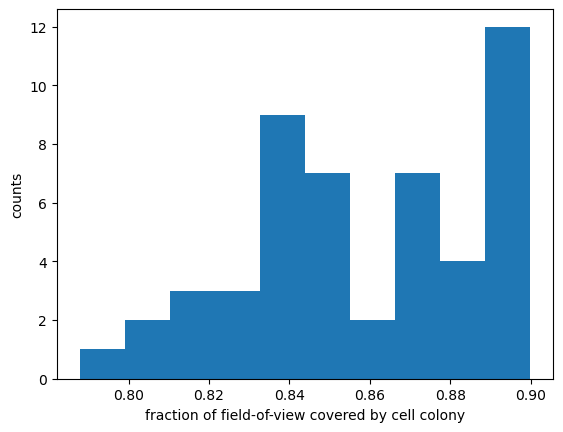

In [163]:
plt.hist(all_cell_mask_cell_pixel_fraction)
plt.xlabel('fraction of field-of-view covered by cell colony')
plt.ylabel('counts')

In [164]:
df = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_myosin1eko_osmotic_shock.csv')


In [165]:
df

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
0,301.0,111.921472,787.368266,1242.674751,301.0,241.0,289.0,5.938151,6.334813,5.710998,0.346673,0.481682,0.199371,4.0,0,1,0-1
1,301.0,172.054960,224.656267,44.344075,301.0,81.0,3.0,13.936697,14.635532,12.507730,0.330439,0.914728,1.636828,4.0,0,1,0-1
2,301.0,138.037334,377.386961,409.659829,301.0,60.0,74.0,15.849563,15.606718,15.558694,0.333345,0.724499,0.767081,4.0,0,1,0-1
3,301.0,97.542351,240.853561,135.182757,301.0,92.0,31.0,13.508203,14.994899,14.215713,0.353514,0.641855,1.195068,4.0,0,1,0-1
4,301.0,194.587562,488.472040,467.910203,301.0,144.0,73.0,7.359216,5.513263,6.522712,0.288084,0.777583,1.015460,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11058,22.0,48.754849,99.764131,336.681183,14.0,5.0,24.0,1.808376,2.871568,1.427950,0.713694,1.198672,0.637352,1.0,4,3,4-7
11059,22.0,51.664630,453.453775,148.149745,22.0,7.0,12.0,5.755096,3.953967,1.251493,0.934569,1.037163,0.862705,1.0,4,3,4-7
11060,21.0,34.109537,471.453953,414.408238,9.0,9.0,11.0,1.862765,3.503746,2.130715,0.959435,0.728922,0.758019,1.0,4,3,4-7
11061,20.0,49.303533,490.566701,454.415789,12.0,20.0,8.0,1.560402,1.592108,4.602407,1.067954,0.225217,0.907467,1.0,4,3,4-7


In [166]:
df_track_cat1 = df[df['track_category'] == 1]


In [167]:
df_track_cat1

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
76,286.0,115.562043,344.735370,161.320298,259.0,82.0,3.0,27.756987,21.221990,24.496872,0.503616,0.860660,0.602099,1.0,0,1,0-1
77,273.0,144.666060,189.105472,390.276143,225.0,23.0,61.0,3.208948,3.283370,3.208948,0.331062,0.873985,0.939367,1.0,0,1,0-1
78,272.0,106.969221,233.029414,140.299478,224.0,22.0,25.0,26.479844,28.760312,28.339366,0.485016,0.990656,0.627006,1.0,0,1,0-1
79,251.0,228.779618,310.695146,98.965962,249.0,53.0,17.0,1.118689,1.558650,3.193351,0.368821,1.057266,1.514498,1.0,0,1,0-1
80,250.0,142.176612,219.312309,141.386004,234.0,16.0,25.0,12.362429,13.478791,8.044673,0.402816,1.018061,1.288743,1.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11058,22.0,48.754849,99.764131,336.681183,14.0,5.0,24.0,1.808376,2.871568,1.427950,0.713694,1.198672,0.637352,1.0,4,3,4-7
11059,22.0,51.664630,453.453775,148.149745,22.0,7.0,12.0,5.755096,3.953967,1.251493,0.934569,1.037163,0.862705,1.0,4,3,4-7
11060,21.0,34.109537,471.453953,414.408238,9.0,9.0,11.0,1.862765,3.503746,2.130715,0.959435,0.728922,0.758019,1.0,4,3,4-7
11061,20.0,49.303533,490.566701,454.415789,12.0,20.0,8.0,1.560402,1.592108,4.602407,1.067954,0.225217,0.907467,1.0,4,3,4-7


In [168]:
condition_counts = (
    df_track_cat1
    .groupby(['condition','replicate','cell_id'])
    .size()
    .reset_index(name='event_count')
)

In [169]:
# Step 1: Add pixel fractions to the condition_counts DataFrame
# Assuming the order of all_cell_mask_cell_pixel_fraction matches the rows in condition_counts
condition_counts['pixel_fraction'] = all_cell_mask_cell_pixel_fraction

# Step 2: Define normalization factor
normalization_factor = 0.108 * 0.108 * 512 * 512 * 5  # in microns² and per 5 minutes

# Step 3: Compute initiation rates
condition_counts['initiation_rate'] = (
    condition_counts['event_count'] / (condition_counts['pixel_fraction'] * normalization_factor)
)


In [170]:
# Group by condition + replicate to get mean per replicate
replicate_means = (
    condition_counts
    .groupby(['condition', 'replicate'])['initiation_rate']
    .mean()
    .reset_index(name='mean_initiation_rate')
)


In [554]:
import os
import glob
import tifffile
folder_path = '/Volumes/Sam_002/Analysis/Osmotic_arpc3_20per'

# Find all cellmask.tif files recursively
mask_paths = glob.glob(os.path.join(folder_path, '**', 'cellmask.tif'), recursive=True)

# Load each mask into a list
all_cell_masks = []
for path in mask_paths:
    mask = tifffile.imread(path)
    all_cell_masks.append(mask)

print(len(all_cell_masks))

48


In [555]:
file_paths = glob.glob(os.path.join(folder_path, '**', 'Ch1', 'C1-*.tif'), recursive=True)
all_cell_tiffs = []
for path in file_paths:
    tiff = tifffile.imread(path)
    all_cell_tiffs.append(tiff)

print(len(all_cell_tiffs))



48


/var/folders/dr/7wv8s9zx3kz0dvq5s3ss_ttc0000gn/T/ipykernel_41842/3480817017.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(5, 5))


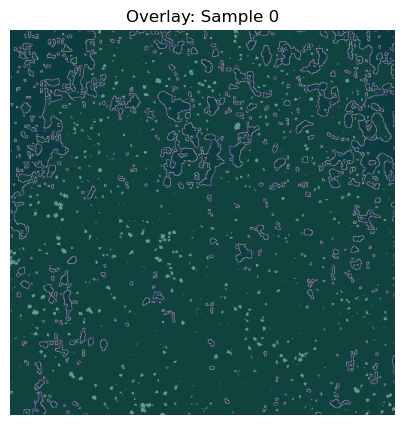

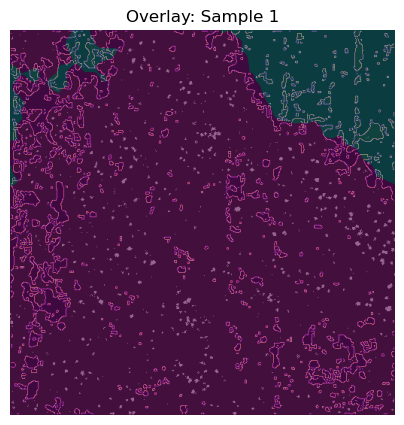

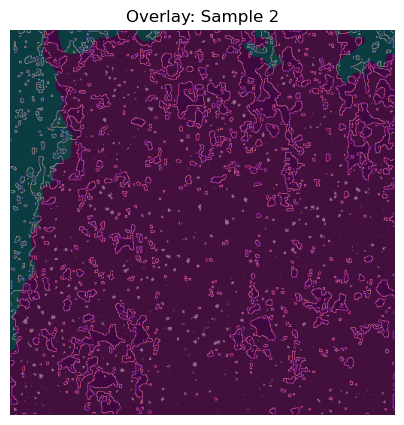

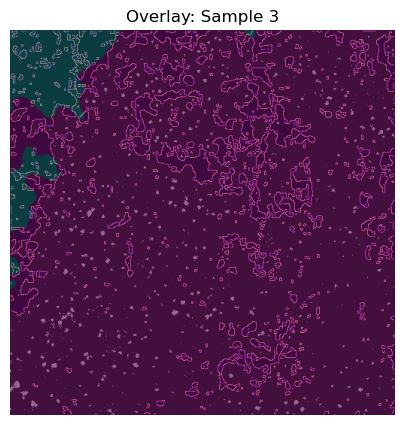

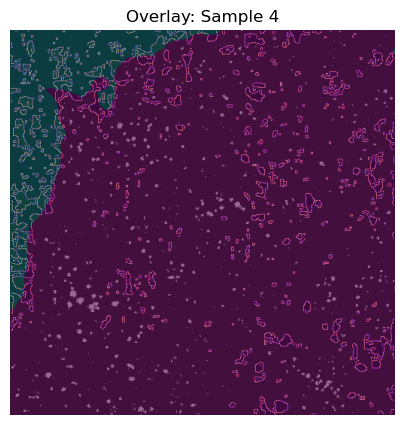

...

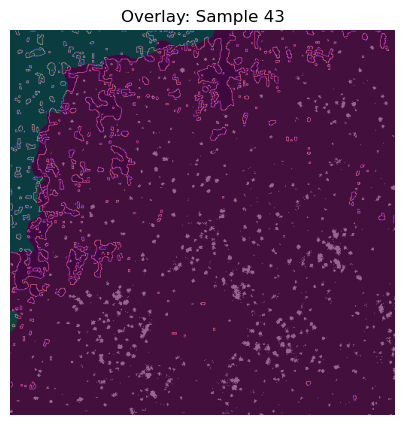

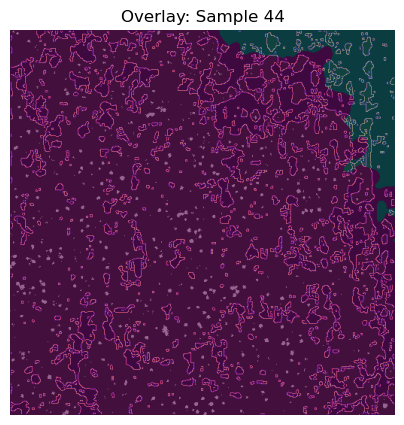

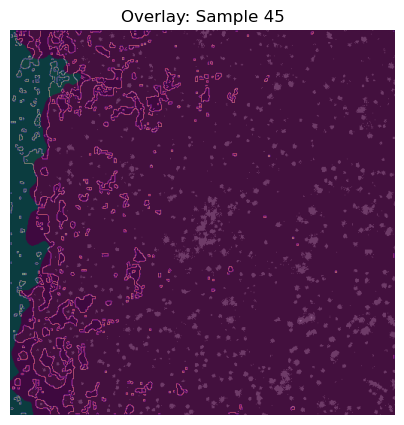

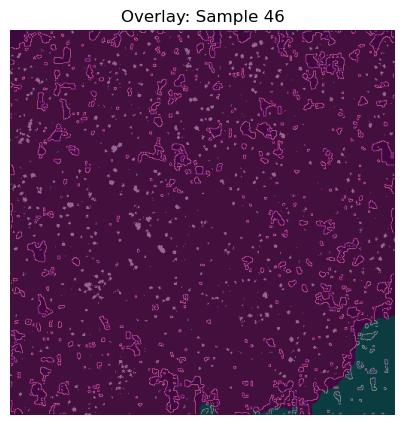

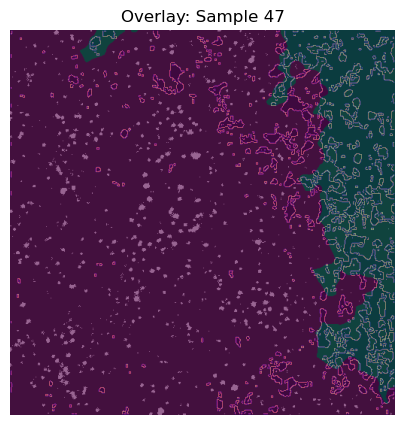

In [556]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.filters import median
from skimage.morphology import disk
from skimage import feature, exposure

# List to store the fraction of "cell pixels" per image
all_cell_mask_cell_pixel_fraction = []

for i, raw_stack in enumerate(all_cell_tiffs):
    # Use the first frame of the image stack
    raw_image = raw_stack[0]

    # Convert to grayscale if needed
    if raw_image.ndim == 3 and raw_image.shape[2] == 3:
        grayscale_image = rgb2gray(raw_image)
    else:
        grayscale_image = raw_image

    # Smooth the grayscale image
    grayscale_image = median(grayscale_image, disk(5))

    # Calculate a threshold from the 10th percentile
    percentile_threshold = np.percentile(grayscale_image.flatten(), 10)

    # Find edges using the Canny detector
    thresholded = grayscale_image > percentile_threshold
    edges = feature.canny(thresholded, sigma=1)

    # Overlay visualization
    plt.figure(figsize=(5, 5))
    plt.imshow(exposure.adjust_gamma(raw_image, 0.00001), alpha=0.9, cmap='gray')
    plt.imshow(thresholded, alpha=0.08, cmap='viridis')
    plt.imshow(edges, alpha=0.5, cmap='magma')
    plt.imshow(all_cell_masks[i], alpha=0.2, cmap='cool')  # Assumes binary mask

    plt.axis('off')
    plt.title(f'Overlay: Sample {i}')
    # plt.show()  # Uncomment to display

    # Calculate the fraction of image area above threshold
    cell_pixel_fraction = thresholded.sum() / (thresholded.shape[0] * thresholded.shape[1])
    all_cell_mask_cell_pixel_fraction.append(cell_pixel_fraction)


Text(0, 0.5, 'counts')

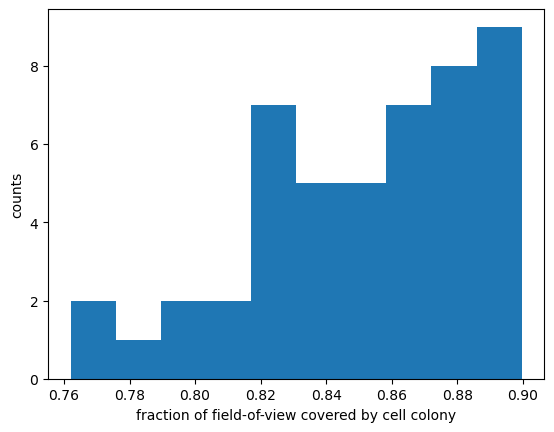

In [557]:
plt.hist(all_cell_mask_cell_pixel_fraction)
plt.xlabel('fraction of field-of-view covered by cell colony')
plt.ylabel('counts')

In [558]:
df = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_arpc3_osmotic_shock.csv')


In [559]:
df

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
0,301.0,235.452121,362.239235,103.323396,301.0,272.0,19.0,11.351544,12.602938,10.935505,0.340316,0.421110,0.791221,4.0,0,1,0-1
1,301.0,192.093923,688.115274,846.214071,301.0,94.0,116.0,4.615408,5.433704,3.639090,0.268044,0.681442,0.293734,4.0,0,1,0-1
2,301.0,242.375038,257.235978,703.419874,301.0,113.0,38.0,9.648803,9.662083,9.701559,0.316612,0.978828,0.869197,4.0,0,1,0-1
3,301.0,95.275189,304.808597,596.843200,301.0,85.0,10.0,7.664193,7.601938,7.664193,0.406973,0.467749,0.618242,4.0,0,1,0-1
4,301.0,151.532054,235.245537,150.926065,301.0,106.0,24.0,2.693844,2.663848,2.693844,0.438494,0.706984,0.620193,4.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11807,22.0,38.409054,455.563197,1806.357570,10.0,15.0,32.0,4.233539,1.329120,0.802131,1.146507,0.565367,0.322058,1.0,4,3,4-6
11808,22.0,46.234919,700.688776,629.938414,12.0,22.0,3.0,2.073671,1.269785,3.361206,1.180578,0.213426,0.520908,1.0,4,3,4-6
11809,21.0,35.555004,119.043815,567.704043,10.0,7.0,7.0,1.280883,2.448225,2.604967,1.297411,0.719445,0.861697,1.0,4,3,4-6
11810,21.0,37.406877,542.706770,232.815722,10.0,21.0,20.0,1.987768,1.066838,4.579294,0.729060,0.515346,0.468281,1.0,4,3,4-6


In [560]:
df_track_cat1 = df[df['track_category'] == 1]


In [561]:
df_track_cat1

,lifetime,max_ch1,max_ch2,max_ch3,ch1_lifetime,ch2_lifetime,ch3_lifetime,ch1_dist,ch2_dist,ch3_dist,md_ch1,md_ch2,md_ch3,track_category,condition,replicate,cell_id
76,275.0,166.464082,215.051461,230.731257,252.0,37.0,57.0,4.729231,4.068313,7.394982,0.424617,1.177585,1.352052,1.0,0,1,0-1
77,266.0,217.536535,308.786780,399.332584,255.0,120.0,29.0,3.181642,3.946879,4.380996,0.476445,0.831229,0.848196,1.0,0,1,0-1
78,244.0,139.115088,272.995742,186.450923,223.0,80.0,18.0,27.348828,24.339479,21.606088,0.517828,0.894437,1.915785,1.0,0,1,0-1
79,240.0,125.633986,210.051041,326.472993,235.0,51.0,17.0,1.286378,5.118118,3.269917,0.440588,0.886334,1.081800,1.0,0,1,0-1
80,224.0,171.894380,580.054619,759.414973,212.0,102.0,9.0,12.815957,9.590555,10.190240,0.604435,0.721779,0.631724,1.0,0,1,0-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11807,22.0,38.409054,455.563197,1806.357570,10.0,15.0,32.0,4.233539,1.329120,0.802131,1.146507,0.565367,0.322058,1.0,4,3,4-6
11808,22.0,46.234919,700.688776,629.938414,12.0,22.0,3.0,2.073671,1.269785,3.361206,1.180578,0.213426,0.520908,1.0,4,3,4-6
11809,21.0,35.555004,119.043815,567.704043,10.0,7.0,7.0,1.280883,2.448225,2.604967,1.297411,0.719445,0.861697,1.0,4,3,4-6
11810,21.0,37.406877,542.706770,232.815722,10.0,21.0,20.0,1.987768,1.066838,4.579294,0.729060,0.515346,0.468281,1.0,4,3,4-6


In [562]:
new_row = {
    'condition': 0,
    'replicate': 3,
    'cell_id': '0-18'
}


# Convert the dict to a 1-row DataFrame
new_row_df = pd.DataFrame([new_row])

# Concatenate the row to the existing DataFrame
df_track_cat1 = pd.concat([df_track_cat1, new_row_df], ignore_index=True)


condition_counts = (
    df_track_cat1
    .groupby(['condition','replicate','cell_id'])
    .size()
    .reset_index(name='event_count')
)


In [563]:
# Step 1: Add pixel fractions to the condition_counts DataFrame
# Assuming the order of all_cell_mask_cell_pixel_fraction matches the rows in condition_counts
condition_counts['pixel_fraction'] = all_cell_mask_cell_pixel_fraction

# Step 2: Define normalization factor
normalization_factor = 0.108 * 0.108 * 512 * 512 * 5  # in microns² and per 5 minutes

# Step 3: Compute initiation rates
condition_counts['initiation_rate'] = (
    condition_counts['event_count'] / (condition_counts['pixel_fraction'] * normalization_factor)
)


In [564]:
# Group by condition + replicate to get mean per replicate
replicate_means = (
    condition_counts
    .groupby(['condition', 'replicate'])['initiation_rate']
    .mean()
    .reset_index(name='mean_initiation_rate')
)


In [108]:
df_arpc3_minus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/two_color_tracking_arpc3_osmotic_shock.csv')
df_arpc3_plus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_arpc3_osmotic_shock.csv')

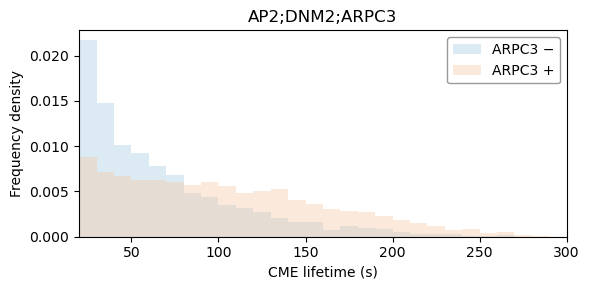

In [110]:
# Filter for condition 0 and track_category 1
lifetimes_minus = df_arpc3_minus[
    (df_arpc3_minus['condition'] == 0) & (df_arpc3_minus['track_category'] == 1)
]['lifetime'] 

lifetimes_plus = df_arpc3_plus[
    (df_arpc3_plus['condition'] == 0) & (df_arpc3_plus['track_category'] == 1)
]['lifetime'] 

# Convert to NumPy arrays just in case
lifetimes_minus = lifetimes_minus.dropna().to_numpy()
lifetimes_plus = lifetimes_plus.dropna().to_numpy()

# Define histogram bins
bins = np.arange(0, 300, 10)

# Plot
plt.figure(figsize=(6, 3))

plt.hist(
    lifetimes_minus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#A9CCE3',
    label='ARPC3 −'
)

plt.hist(
    lifetimes_plus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#F5CBA7',
    label='ARPC3 +'
)

# Labels and aesthetics
plt.xlabel('CME lifetime (s)')
plt.ylabel('Frequency density')
plt.legend(frameon=True, edgecolor='gray')
plt.title('AP2;DNM2;ARPC3')
plt.xlim(20, 300)
plt.ylim(0, None)
plt.tight_layout()
plt.savefig('lifetimes_ADA.png', dpi=300, bbox_inches='tight')
plt.show()


In [111]:
df_arpc3_minus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/two_color_tracking_myosin1eko_osmotic_shock.csv')
df_arpc3_plus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_myosin1eko_osmotic_shock.csv')

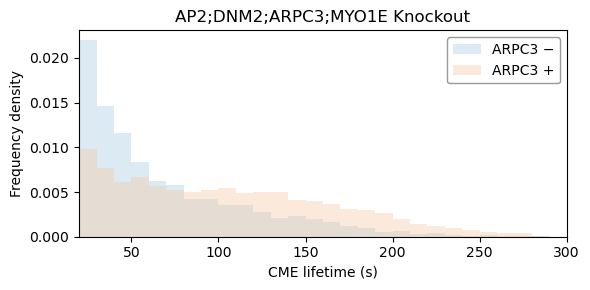

In [112]:
# Filter for condition 0 and track_category 1
lifetimes_minus = df_arpc3_minus[
    (df_arpc3_minus['condition'] == 0) & (df_arpc3_minus['track_category'] == 1)
]['lifetime'] 

lifetimes_plus = df_arpc3_plus[
    (df_arpc3_plus['condition'] == 0) & (df_arpc3_plus['track_category'] == 1)
]['lifetime'] 

# Convert to NumPy arrays just in case
lifetimes_minus = lifetimes_minus.dropna().to_numpy()
lifetimes_plus = lifetimes_plus.dropna().to_numpy()

# Define histogram bins
bins = np.arange(0, 300, 10)

# Plot
plt.figure(figsize=(6, 3))

plt.hist(
    lifetimes_minus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#A9CCE3',
    label='ARPC3 −'
)

plt.hist(
    lifetimes_plus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#F5CBA7',
    label='ARPC3 +'
)

# Labels and aesthetics
plt.xlabel('CME lifetime (s)')
plt.ylabel('Frequency density')
plt.title('AP2;DNM2;ARPC3;MYO1E Knockout')
plt.legend(frameon=True, edgecolor='gray')
plt.xlim(20, 300)
plt.ylim(0, None)
plt.tight_layout()
plt.savefig('lifetime_MDKO.png', dpi=300, bbox_inches='tight')
plt.show()


In [5]:
df_myo1e_minus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/two_color_tracking_myosin1e_osmotic_shock.csv')
df_myo1e_plus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_myosin1e_osmotic_shock.csv')

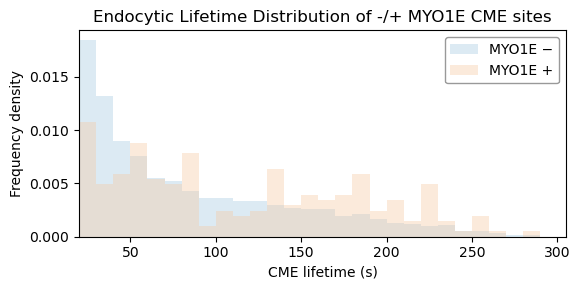

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Filter for condition 0 and track_category 1
lifetimes_minus = df_myo1e_minus[
    (df_myo1e_minus['condition'] == 0) & (df_myo1e_minus['track_category'] == 1)
]['lifetime'] 

lifetimes_plus = df_myo1e_plus[
    (df_myo1e_plus['condition'] == 0) & (df_myo1e_plus['track_category'] == 1)
]['lifetime'] 

# Convert to NumPy arrays just in case
lifetimes_minus = lifetimes_minus.dropna().to_numpy()
lifetimes_plus = lifetimes_plus.dropna().to_numpy()

# Define histogram bins
bins = np.arange(0, 300, 10)

# Plot
plt.figure(figsize=(6, 3))

# Histogram plots
plt.hist(
    lifetimes_minus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#A9CCE3',
    label='MYO1E −'
)

plt.hist(
    lifetimes_plus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#F5CBA7',
    label='MYO1E +'
)

# KDE overlays
#sns.kdeplot(lifetimes_minus, color='#2874A6', linewidth=2, label='KDE MYO1E-', bw_adjust = 0.6)
#sns.kdeplot(lifetimes_plus, color='#CA6F1E', linewidth=2, label='KDE MYO1E+', bw_adjust = 0.6)

# Labels and aesthetics
plt.xlabel('CME lifetime (s)')
plt.ylabel('Frequency density')
plt.title('Endocytic Lifetime Distribution of -/+ MYO1E CME sites')
plt.legend(frameon=True, edgecolor='gray')
plt.xlim(20, 305)
plt.ylim(0, None)
plt.tight_layout()
plt.savefig('lifetime_myo1e.png', dpi=300, bbox_inches='tight')
plt.show()



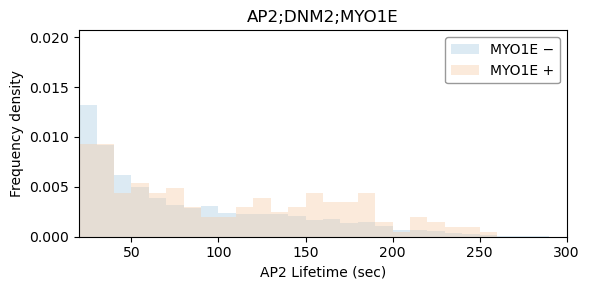

In [183]:
# Filter for condition 0 and track_category 1
lifetimes_minus = df_myo1e_minus[
    (df_myo1e_minus['condition'] == 0) & (df_myo1e_minus['track_category'] == 1)
]['ch1_lifetime'] 

lifetimes_plus = df_myo1e_plus[
    (df_myo1e_plus['condition'] == 0) & (df_myo1e_plus['track_category'] == 1)
]['ch1_lifetime'] 

# Convert to NumPy arrays just in case
lifetimes_minus = lifetimes_minus.dropna().to_numpy()
lifetimes_plus = lifetimes_plus.dropna().to_numpy()

# Define histogram bins
bins = np.arange(0, 300, 10)

# Plot
plt.figure(figsize=(6, 3))

plt.hist(
    lifetimes_minus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#A9CCE3',
    label='MYO1E −'
)

plt.hist(
    lifetimes_plus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#F5CBA7',
    label='MYO1E +'
)

# Labels and aesthetics
plt.xlabel('AP2 Lifetime (sec)')
plt.ylabel('Frequency density')
plt.title('AP2;DNM2;MYO1E')
plt.legend(frameon=True, edgecolor='gray')
plt.xlim(20, 300)
plt.ylim(0, None)
plt.tight_layout()
plt.savefig('lifetime_myo1e.png', dpi=500, bbox_inches='tight')
plt.show()

In [598]:
df_arpc3_minus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_myosin1eko_osmotic_shock.csv')
df_arpc3_plus = pd.read_csv('/Users/samanthasmith/Documents/Drubin_Lab/CME_Analysis/Jin_Shirazinejad_et_al_branched_actin_manuscript-main 2/analysis/Osmotic_Shock/three_color_tracking_arpc3_osmotic_shock.csv')


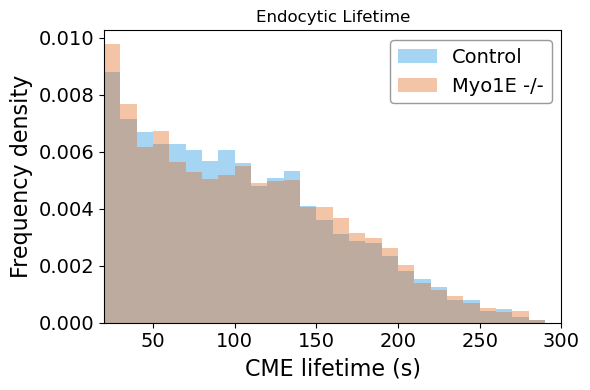

In [599]:
# Filter for condition 0 and track_category 1
lifetimes_minus = df_arpc3_minus[
    (df_arpc3_minus['condition'] == 0) & (df_arpc3_minus['track_category'] == 1)
]['lifetime'] 

lifetimes_plus = df_arpc3_plus[
    (df_arpc3_plus['condition'] == 0) & (df_arpc3_plus['track_category'] == 1)
]['lifetime'] 

# Convert to NumPy arrays just in case
lifetimes_minus = lifetimes_minus.dropna().to_numpy()
lifetimes_plus = lifetimes_plus.dropna().to_numpy()

# Define histogram bins
bins = np.arange(0, 300, 10)

# Plot
plt.figure(figsize=(6, 4))

plt.hist(
    lifetimes_plus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#2196E3',
    label='Control'
)

plt.hist(
    lifetimes_minus,
    bins=bins,
    density=True,
    alpha=0.4,
    color='#E36E21',
    label='Myo1E -/-'
)


# Labels and aesthetics
plt.xlabel('CME lifetime (s)', fontsize = 16)
plt.ylabel('Frequency density',fontsize = 16)
plt.title('Endocytic Lifetime')
plt.legend(frameon=True, edgecolor='gray', fontsize = 14)
plt.xlim(20, 300)
plt.xticks (fontsize = 14)
plt.yticks (fontsize = 14)
plt.ylim(0, None)
plt.tight_layout()
plt.savefig('arpc3vdko_lifetime.png', dpi=300, bbox_inches='tight')
plt.show()


In [15]:
condition_pathname = '/Volumes/Sam_002/Analysis/Osmotic_myosin/'
folder_to_process = '0'  # Specify the folder to process (e.g., '0')

processed_tracks_condition = []
processed_tracks_filepath = 'Ch1/Tracking/ProcessedTracks.mat'

# Path to the specific folder
tracks_path_condition = os.path.join(condition_pathname, folder_to_process)

# Get all directories in the folder
condition_cell_directories = [
    os.path.join(tracks_path_condition, file)
    for file in os.listdir(tracks_path_condition)
    if os.path.isdir(os.path.join(tracks_path_condition, file))
]

# Generate paths for all processed track files
for directory in condition_cell_directories:
    processed_tracks_condition.append(os.path.join(directory, processed_tracks_filepath))

# Output the number of files found
print(f"Number of processed tracks in folder {folder_to_process}: {len(processed_tracks_condition)}")


Number of processed tracks in folder 0: 24


In [16]:
#loading and filtering a single processed tracks file. Also tracking condition information

filtered_valid_tracks_all = []

for i in range(len(processed_tracks_condition)):
    loaded_tracks = []
    loaded_tracks.append(display_tracks.load_tracks(processed_tracks_condition[i]))

    valid_tracks = []
    for tracks in loaded_tracks:
        valid_tracks.append(display_tracks.remove_tracks_by_criteria(tracks, track_category=[1]))

        
    for tracks in valid_tracks:
        temp_track_ccps = filter_for_ccps(tracks,
                                          minimum_ch2_counts=3,
                                          sig_pval_cutoff=0.01,
                                          minimum_lifetime=20,
                                          maximum_lifetime=300,
                                          initial_msd_threshold=0.02,
                                          pixel_size=0.108)
            
        
        filtered_valid_tracks_all.append(temp_track_ccps)

# Now all_filtered_tracks contains all the tracks from filtered_valid_tracks


The number of tracks returned: 2755



100%|███████████████████████████████████| 2755/2755 [00:00<00:00, 176908.47it/s]


The number of tracks returned: 2699



100%|███████████████████████████████████| 2699/2699 [00:00<00:00, 166454.83it/s]


The number of tracks returned: 2187



100%|███████████████████████████████████| 2187/2187 [00:00<00:00, 162952.87it/s]


The number of tracks returned: 2152



100%|███████████████████████████████████| 2152/2152 [00:00<00:00, 163389.79it/s]


The number of tracks returned: 2410



100%|███████████████████████████████████| 2410/2410 [00:00<00:00, 162048.68it/s]


The number of tracks returned: 2288



100%|███████████████████████████████████| 2288/2288 [00:00<00:00, 163839.44it/s]


The number of tracks returned: 1764



100%|███████████████████████████████████| 1764/1764 [00:00<00:00, 181404.21it/s]


The number of tracks returned: 2434



100%|███████████████████████████████████| 2434/2434 [00:00<00:00, 172491.95it/s]


The number of tracks returned: 2378



100%|███████████████████████████████████| 2378/2378 [00:00<00:00, 176948.48it/s]


The number of tracks returned: 2566



100%|███████████████████████████████████| 2566/2566 [00:00<00:00, 148746.93it/s]


The number of tracks returned: 1884



100%|███████████████████████████████████| 1884/1884 [00:00<00:00, 181715.24it/s]


The number of tracks returned: 1907



100%|███████████████████████████████████| 1907/1907 [00:00<00:00, 178510.90it/s]


The number of tracks returned: 2011



100%|███████████████████████████████████| 2011/2011 [00:00<00:00, 181158.62it/s]


The number of tracks returned: 2152



100%|███████████████████████████████████| 2152/2152 [00:00<00:00, 182630.40it/s]


The number of tracks returned: 2027



100%|███████████████████████████████████| 2027/2027 [00:00<00:00, 172921.41it/s]


The number of tracks returned: 2311



100%|███████████████████████████████████| 2311/2311 [00:00<00:00, 173916.04it/s]


The number of tracks returned: 2186



100%|███████████████████████████████████| 2186/2186 [00:00<00:00, 176403.50it/s]


The number of tracks returned: 2354



100%|███████████████████████████████████| 2354/2354 [00:00<00:00, 182874.45it/s]


The number of tracks returned: 1951



100%|███████████████████████████████████| 1951/1951 [00:00<00:00, 187054.82it/s]


The number of tracks returned: 2180



100%|███████████████████████████████████| 2180/2180 [00:00<00:00, 177669.49it/s]


The number of tracks returned: 2079



100%|███████████████████████████████████| 2079/2079 [00:00<00:00, 187824.88it/s]


The number of tracks returned: 2222



100%|███████████████████████████████████| 2222/2222 [00:00<00:00, 172972.23it/s]


The number of tracks returned: 2505



100%|███████████████████████████████████| 2505/2505 [00:00<00:00, 171858.34it/s]


The number of tracks returned: 2351



100%|███████████████████████████████████| 2351/2351 [00:00<00:00, 177877.35it/s]


In [17]:
import itertools
from tqdm import tqdm

# Output lists
ch3_count_gte_3 = []
ch3_count_lt_3 = []

# Loop over each cell's track list
for cell_tracks in filtered_valid_tracks_all:
    gte_3 = []
    lt_3 = []

    for track in cell_tracks:
        pvals = track[index_dictionary['index_pval_Ar']][2]
        significant_pval_indices = [1 if pval < 0.01 else 0 for pval in pvals]
        repeated_indices = [(x[0], len(list(x[1]))) for x in itertools.groupby(significant_pval_indices)]
        max_1s = max((length for val, length in repeated_indices if val == 1), default=0)

        if max_1s >= 3:
            gte_3.append(track)
        else:
            lt_3.append(track)

    ch3_count_gte_3.append(gte_3)
    ch3_count_lt_3.append(lt_3)


In [18]:
#Extracting intensity over time (Amplitude) from tfn positive tracks

tracks_compiled_neg= []
for tracks in ch3_count_lt_3:
    for track in tracks:
        tracks_compiled_neg.append(track)

print(len(tracks_compiled_neg))

channel_amps_neg = []
for i in range(len(tracks_compiled_neg)):
#         print(i)
    ch0 = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_compiled_neg, i, 0)
    ch1 = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_compiled_neg, i, 1)
    channel_amps_neg.append(list([ch0, ch1]))


tracks_compiled_pos = []
for tracks in ch3_count_gte_3:
    for track in tracks:
        tracks_compiled_pos.append(track)

print(len(tracks_compiled_pos))

channel_amps_pos = []
for i in range(len(tracks_compiled_pos)):
#         print(i)
    ch0 = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_compiled_pos, i, 0)
    ch1 = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_compiled_pos, i, 1)
    ch2 = return_track_attributes.return_track_amplitude_no_buffer_channel(tracks_compiled_pos, i, 2)
    channel_amps_pos.append(list([ch0, ch1,ch2]))


4589
183


In [19]:
import numpy as np

def safe_normalize_trace(trace):
    max_val = np.nanmax(trace)
    if max_val and not np.isnan(max_val) and max_val > 0:
        return (trace / max_val) * 1
    else:
        return trace  # Leave unchanged if max is 0 or invalid

normalized_channel_amps_pos = []

for ch0, ch1, ch2 in channel_amps_pos:
    norm_ch0 = safe_normalize_trace(np.array(ch0))
    norm_ch1 = safe_normalize_trace(np.array(ch1))
    norm_ch2 = safe_normalize_trace(np.array(ch2))
    normalized_channel_amps_pos.append([norm_ch0, norm_ch1, norm_ch2])

normalized_channel_amps_neg = []

for ch0, ch1 in channel_amps_neg:
    norm_ch0 = safe_normalize_trace(np.array(ch0))
    norm_ch1 = safe_normalize_trace(np.array(ch1))
    normalized_channel_amps_neg.append([norm_ch0, norm_ch1])


[0]
[0]


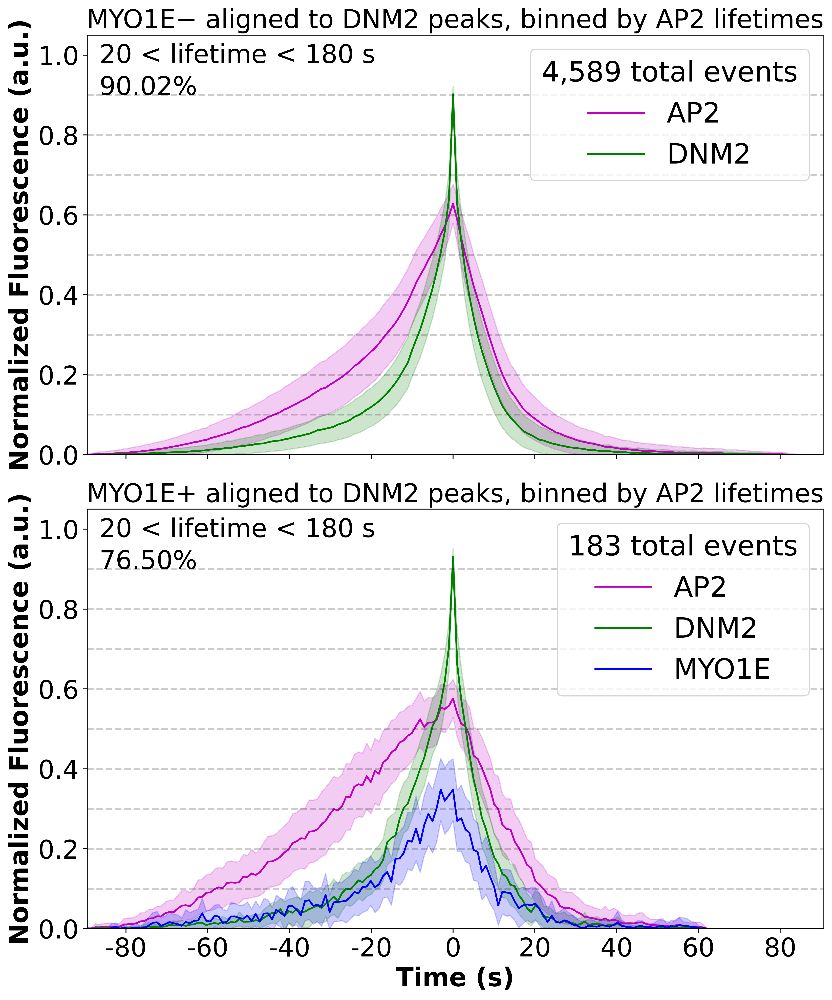

In [35]:
plt.style.use('default')

fig, axes = plt.subplots(2, 1, dpi=500, figsize=(10, 12), sharex=True)

cohorts = [[20, 180]]

# --- Plot NEGATIVE (MYO1E−) first ---
offsets, num_in_cohort_neg, max_dnm2_indices_neg = display_tracks.plot_separated_cohorts(
    [axes[0]],
    normalized_channel_amps_neg,
    1,
    cohorts,
    [0, 1],
    [],
    ['AP2', 'DNM2'],
    ['m', 'g']
)

lines_0, labels_0 = axes[0].get_legend_handles_labels()
axes[0].legend(lines_0, labels_0, loc='upper right', fontsize=24,
               title=f"{len(normalized_channel_amps_neg):,} total events", title_fontsize=24)

axes[0].set_title('MYO1E− aligned to DNM2 peaks, binned by AP2 lifetimes', fontsize=22)
axes[0].set_ylabel('Normalized Fluorescence (a.u.)', fontsize=22, fontweight = "bold")

axes[0].set_ylim([0, 1.05])
axes[0].tick_params(labelsize=22)

# Annotations for negative
axes[0].text(3, 0.98, f"{cohorts[0][0]} < lifetime < {cohorts[0][1]} s", fontsize=22)
axes[0].text(3, 0.90, f"{100 * num_in_cohort_neg[0] / len(normalized_channel_amps_neg):.2f}%", fontsize=22)

# --- Plot POSITIVE (MYO1E+) second ---
offsets, num_in_cohort_pos, max_dnm2_indices_pos = display_tracks.plot_separated_cohorts(
    [axes[1]],
    normalized_channel_amps_pos,
    1,
    cohorts,
    [0, 1, 2],
    [],
    ['AP2', 'DNM2', 'MYO1E'],
    ['m', 'g', 'b']
)

lines_1, labels_1 = axes[1].get_legend_handles_labels()
axes[1].legend(lines_1, labels_1, loc='upper right', fontsize=24,
               title=f"{len(normalized_channel_amps_pos):,} total events", title_fontsize=24)

axes[1].set_title('MYO1E+ aligned to DNM2 peaks, binned by AP2 lifetimes', fontsize=22)
axes[1].set_ylabel('Normalized Fluorescence (a.u.)', fontsize=22, fontweight = "bold")
axes[1].set_xlabel('Time (s)', fontsize=22,fontweight = "bold")

axes[1].set_ylim([0, 1.05])
axes[1].tick_params(labelsize=22)

# Annotations for positive
axes[1].text(3, 0.98, f"{cohorts[0][0]} < lifetime < {cohorts[0][1]} s", fontsize=22)
axes[1].text(3, 0.90, f"{100 * num_in_cohort_pos[0] / len(normalized_channel_amps_pos):.2f}%", fontsize=22)

# --- Shared formatting ---
for ax in axes:
    y_lines = np.arange(0.1, 1, 0.1)
    for y in y_lines:
        ax.axhline(y, 0, 1, linestyle='--', color='black', alpha=0.2)

# Set consistent x-axis ticks based on one of the tracks
x_positions_ticks = []
x_labels_ticks = []
max_dnm2_cohort_indices = max_dnm2_indices_pos  # use positive as reference

for i in range(len(max_dnm2_cohort_indices)):
    peak = max_dnm2_cohort_indices[i]
    for j in range(20):
        x_labels_ticks.append(-20 * (20 - j))
        x_positions_ticks.append(-20 * (20 - j) + offsets[i] + peak)
    x_labels_ticks.append(0)
    x_positions_ticks.append(offsets[i] + peak)
    for j in range(8):
        x_labels_ticks.append(20 * (j + 1))
        x_positions_ticks.append(20 * (j + 1) + offsets[i] + peak)

axes[1].set_xticks(0.5 + np.array(x_positions_ticks))
axes[1].set_xticklabels(x_labels_ticks)

axes[0].set_xlim([0, offsets[-1] + cohorts[-1][-1]])
axes[1].set_xlim([0, offsets[-1] + cohorts[-1][-1]])

plt.tight_layout()
fig.savefig('myo1e_cohort_comparison.png', dpi=500, bbox_inches='tight')
plt.show()
